<a href="https://colab.research.google.com/github/probml/pyprobml/blob/master/notebooks/lvm/vae_celeba_tf.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Variational Autoencoder for CelebA






## Import TensorFlow and other libraries

In [0]:
from __future__ import absolute_import, division, print_function, unicode_literals

try:
  # %tensorflow_version only exists in Colab.
  %tensorflow_version 2.x
except Exception:
  pass
import tensorflow as tf
import tensorflow_datasets as tfds
from tensorflow import keras

import os
import time
import numpy as np
import glob
import matplotlib.pyplot as plt
import PIL
import imageio

from IPython import display

## Load the dataset


In [29]:
#dataname = 'mnist' 
dataname = 'celeb_a' # 1.38GB!

datasets, datasets_info = tfds.load(name=dataname, with_info=True, as_supervised=False)
print(datasets_info)

input_shape = datasets_info.features['image'].shape
print(input_shape)
num_colors = input_shape[2]

/usr/local/lib/python3.6/dist-packages/urllib3/connectionpool.py:847: InsecureRequestWarning: Unverified HTTPS request is being made. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#ssl-warnings
  InsecureRequestWarning)
/usr/local/lib/python3.6/dist-packages/urllib3/connectionpool.py:847: InsecureRequestWarning: Unverified HTTPS request is being made. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#ssl-warnings
  InsecureRequestWarning)
/usr/local/lib/python3.6/dist-packages/urllib3/connectionpool.py:847: InsecureRequestWarning: Unverified HTTPS request is being made. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#ssl-warnings
  InsecureRequestWarning)
/usr/local/lib/python3.6/dist-packages/urllib3/connectionpool.py:847: InsecureRequestWarning: Unverified HTTPS request is be

Instructions for updating:
Use eager execution and: 
`tf.data.TFRecordDataset(path)`


Instructions for updating:
Use eager execution and: 
`tf.data.TFRecordDataset(path)`


Dataset celeb_a downloaded and prepared to /root/tensorflow_datasets/celeb_a/0.3.0. Subsequent calls will reuse this data.
tfds.core.DatasetInfo(
    name='celeb_a',
    version=0.3.0,
    description='CelebFaces Attributes Dataset (CelebA) is a large-scale face attributes dataset with more than 200K celebrity images, each with 40 attribute annotations. The images in this dataset cover large pose variations and background clutter. CelebA has large diversities, large quantities, and rich annotations, including
 - 10,177 number of identities,
 - 202,599 number of face images, and
 - 5 landmark locations, 40 binary attributes annotations per image.

The dataset can be employed as the training and test sets for the following computer vision tasks: face attribute recognition, face detection, and landmark (or facial part) localization.
',
    urls=['http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html'],
    features=FeaturesDict({
        'attributes': FeaturesDict({
            '5_o_Clock_Shad

In [0]:
batchsize = 32
# We assume the dataset has a dict of features called image and label.
# We extract the image from the dict, and scale each channel to [0,1]
# We return a tuple (rescaled-image, label).

H = 64
W = 64
input_shape = [H, W, 3]
num_colors = 3

# https://github.com/google/compare_gan/blob/master/compare_gan/datasets.py

def preprocess_celeba_tf(features, crop=True):
    # Crop, resize and scale to [0,1]
     # If input is not square, and we resize to a square, we will 
    # get distortions. So better to take a square crop first..
    img = features["image"]
    if crop:
        img = tf.image.resize_with_crop_or_pad(img, 160, 160)
    img = tf.image.resize(img, [H, W])
    img = tf.cast(img, tf.float32) / 255.0
    #img = img.numpy()
    return img


# We train on the validation set, which has 19k images, for speed
train_dataset = (datasets['validation']
                 .map(preprocess_celeba_tf)
                 .batch(batchsize)
                 .prefetch(tf.data.experimental.AUTOTUNE)
                 .shuffle(int(10e3)))

test_dataset = (datasets['test']
                .map(preprocess_celeba_tf)
                .batch(batchsize)
                .prefetch(tf.data.experimental.AUTOTUNE))



In [32]:
# extract small amount of data for testing
batch = train_dataset.take(1) # slow!!!
first_batch = list(batch)


NameError: ignored

(32, 64, 64, 3)
(3, 64, 64, 3)


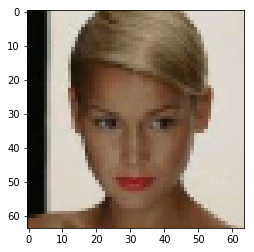

In [34]:
X = first_batch[0]
print(X.shape) # B, H, W, C
Xsmall = X[:3, :, :, :]
print(Xsmall.shape)

plt.imshow(Xsmall[0])

# Define model

In [0]:
from tensorflow.keras.layers import Input, Conv2D, Flatten, Dense, Conv2DTranspose, Reshape, Lambda, Activation, BatchNormalization, LeakyReLU, Dropout
from tensorflow.keras import backend as K
from tensorflow.keras.models import Model

In [0]:
def make_encoder(
        input_dim,
        z_dim,
        encoder_conv_filters,
        encoder_conv_kernel_size,
        encoder_conv_strides,
        use_batch_norm = False,
        use_dropout= False
        ):
  encoder_input = Input(shape=input_dim, name='encoder_input')
  x = encoder_input
  n_layers_encoder = len(encoder_conv_filters)
  for i in range(n_layers_encoder):
      conv_layer = Conv2D(
          filters = encoder_conv_filters[i]
          , kernel_size = encoder_conv_kernel_size[i]
          , strides = encoder_conv_strides[i]
          , padding = 'same'
          , name = 'encoder_conv_' + str(i)
          )
      x = conv_layer(x)
      if use_batch_norm:
          x = BatchNormalization()(x)
      x = LeakyReLU()(x)
      if use_dropout:
          x = Dropout(rate = 0.25)(x)
  shape_before_flattening = K.int_shape(x)[1:]
  x = Flatten()(x)
  mu = Dense(z_dim, name='mu')(x) # no activation
  log_var = Dense(z_dim, name='log_var')(x) # no activation
  encoder = Model(encoder_input, (mu, log_var))
  return encoder, shape_before_flattening



In [0]:
def make_decoder(
        shape_before_flattening,
        z_dim,
        decoder_conv_t_filters,
        decoder_conv_t_kernel_size,
        decoder_conv_t_strides,
        use_batch_norm = False,
        use_dropout= False
        ):
  decoder_input = Input(shape=(z_dim,), name='decoder_input')
  x = Dense(np.prod(shape_before_flattening))(decoder_input)
  x = Reshape(shape_before_flattening)(x)
  n_layers_decoder = len(decoder_conv_t_filters)
  for i in range(n_layers_decoder):
      conv_t_layer = Conv2DTranspose(
          filters = decoder_conv_t_filters[i]
          , kernel_size = decoder_conv_t_kernel_size[i]
          , strides = decoder_conv_t_strides[i]
          , padding = 'same'
          , name = 'decoder_conv_t_' + str(i)
          )
      x = conv_t_layer(x)
      if i < n_layers_decoder - 1:
          if use_batch_norm:
              x = BatchNormalization()(x)
          x = LeakyReLU()(x)
          if use_dropout:
              x = Dropout(rate = 0.25)(x)
      # No activation fn in final layer since returns logits
      #else:
      #    x = Activation('sigmoid')(x)
  decoder_output = x
  decoder = Model(decoder_input, decoder_output)
  return decoder
  


In [0]:

def log_normal_pdf(sample, mean, logvar, raxis=1):
  log2pi = tf.math.log(2. * np.pi)
  return tf.reduce_sum(
      -.5 * ((sample - mean) ** 2. * tf.exp(-logvar) + logvar + log2pi),
      axis=raxis)

def sample_gauss(mean, logvar):
  eps = tf.random.normal(shape=mean.shape)
  return eps * tf.exp(logvar * .5) + mean

In [0]:
class ConvVAE(tf.keras.Model):
  def __init__(self,
        input_dim,
        latent_dim,
        encoder_conv_filters,
        encoder_conv_kernel_size,
        encoder_conv_strides,
        decoder_conv_t_filters,
        decoder_conv_t_kernel_size,
        decoder_conv_t_strides,
        use_batch_norm = False,
        use_dropout= False,
        recon_loss_scaling = 1,
        kl_loss_scaling = 1,
        use_mse_loss = False
        ):
    super(ConvVAE, self).__init__()
    # Save all args so we can reconstruct this object later
    self.input_dim = input_dim
    self.latent_dim = latent_dim
    self.encoder_conv_filters = encoder_conv_filters
    self.encoder_conv_kernel_size = encoder_conv_kernel_size
    self.encoder_conv_strides = encoder_conv_strides
    self.decoder_conv_t_filters = decoder_conv_t_filters
    self.decoder_conv_t_kernel_size = decoder_conv_t_kernel_size
    self.decoder_conv_t_strides = decoder_conv_t_strides
    self.use_batch_norm = use_batch_norm
    self.use_dropout = use_dropout
    self.recon_loss_scaling = recon_loss_scaling
    self.kl_loss_scaling = kl_loss_scaling
    self.use_mse_loss = use_mse_loss
    
    self.inference_net, self.shape_before_flattening = make_encoder(
        input_dim,
        latent_dim,
        encoder_conv_filters,
        encoder_conv_kernel_size,
        encoder_conv_strides,
        use_batch_norm,
        use_dropout)
    
    self.generative_net = make_decoder(
        self.shape_before_flattening,
        latent_dim,
        decoder_conv_t_filters,
        decoder_conv_t_kernel_size,
        decoder_conv_t_strides,
        use_batch_norm,
        use_dropout)

  @tf.function
  def sample(self, nsamples=1):
    eps = tf.random.normal(shape=(nsamples, self.latent_dim))
    return self.decode(eps, apply_sigmoid=True)

  def encode_stochastic(self, x):
    mean, logvar = self.inference_net(x)
    return sample_gauss(mean, logvar)

  def decode(self, z, apply_sigmoid=True):
    logits = self.generative_net(z)
    if apply_sigmoid:
      probs = tf.sigmoid(logits)
      return probs
    return logits
  
  
  @tf.function
  def compute_loss(self, x):
    mean, logvar = self.inference_net(x)
    z = sample_gauss(mean, logvar)
    if self.use_mse_loss:
      x_probs = self.decode(z, apply_sigmoid=True)
      mse = tf.reduce_mean( (x - x_probs) ** 2, axis=[1, 2, 3])
      logpx_z = -0.5*mse # log exp(-0.5 (x-mu)^2)
    else:
      x_logit = self.decode(z, apply_sigmoid=False)
      cross_ent = tf.nn.sigmoid_cross_entropy_with_logits(logits=x_logit, labels=x) # -sum_{c=0}^1 p_c log q_c
      logpx_z = -tf.reduce_sum(cross_ent, axis=[1, 2, 3]) # sum over H,W,C
    logpz = log_normal_pdf(z, 0., 0.) # prior: mean=0, logvar=0
    logqz_x = log_normal_pdf(z, mean, logvar)
    kl_loss = logpz - logqz_x # MC approximation
    return -tf.reduce_mean(self.recon_loss_scaling * logpx_z + self.kl_loss_scaling * kl_loss) # -ve ELBO


          
  @tf.function
  def compute_gradients(self, x):
    with tf.GradientTape() as tape:
      loss = self.compute_loss(x)
    gradients = tape.gradient(loss, self.trainable_variables)
    return gradients


In [0]:

# Use parameters from
#https://nbviewer.jupyter.org/github/davidADSP/GDL_code/blob/master/03_05_vae_faces_train.ipynb
R_LOSS_FACTOR = 10000
latent_dim = 200

model = ConvVAE(
                input_dim = input_shape
                , latent_dim = latent_dim
                , encoder_conv_filters=[32,64,64, 64]
                , encoder_conv_kernel_size=[3,3,3,3]
                , encoder_conv_strides=[2,2,2,2]
                , decoder_conv_t_filters=[64,64,32,3]
                , decoder_conv_t_kernel_size=[3,3,3,3]
                , decoder_conv_t_strides=[2,2,2,2]
                , use_batch_norm=True
                , use_dropout=True
                , use_mse_loss = True
                , recon_loss_scaling = R_LOSS_FACTOR)

In [42]:
# Test
M, V = model.inference_net(Xsmall)
print(M.shape)
print(V.shape)

Z = model.encode_stochastic(Xsmall)
print(Z.shape)

predictions = model.decode(Z)
print(Z.shape)
print(predictions.shape)


(3, 200)
(3, 200)
(3, 200)
(3, 200)
(3, 64, 64, 3)


In [43]:
L = model.compute_loss(Xsmall)
print(L)
g = model.compute_gradients(Xsmall)
print(g[0].shape) # 3,3,ncolors,32 - size of first layer conv

tf.Tensor(542.7215, shape=(), dtype=float32)
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


(3, 3, 3, 32)


# Code to save model 

Before we start training, make sure we can save and load model...


In [0]:


folder = 'vae_celeba'
if not os.path.exists(folder):
      os.makedirs(folder)
    
# Save args to class constructor as pkl file
# and weights as hd5 file
def save_vae(model, folder):
    with open(os.path.join(folder, 'params.pkl'), 'wb') as f:
        pickle.dump([
            model.input_dim,
            model.latent_dim,
            model.encoder_conv_filters,
            model.encoder_conv_kernel_size,
            model.encoder_conv_strides,
            model.decoder_conv_t_filters,
            model.decoder_conv_t_kernel_size,
            model.decoder_conv_t_strides,
            model.use_batch_norm,
            model.use_dropout,
            model.recon_loss_scaling,
            model.kl_loss_scaling,
            model.use_mse_loss
            ], f)
    model.save_weights(os.path.join(folder, 'weights.h5'))
    

# Generic model loader
def load_model(model_class, folder):
    with open(os.path.join(folder, 'params.pkl'), 'rb') as f:
        params = pickle.load(f)
    model = model_class(*params)
    model.load_weights(os.path.join(folder, 'weights.h5'))
    return model

save_vae(model, folder)



In [45]:
# Check new model gives same results as old model 
model_new = load_model(ConvVAE, folder)

M, V = model.inference_net(Xsmall)
M_new, V_new = model_new.inference_net(Xsmall)
np.allclose(M, M_new)

tf.Tensor(
[[ 0.0320879   0.05222641  0.03146143  0.01531928 -0.08503705 -0.06764032
  -0.07083007  0.00088606  0.02955805  0.02761674 -0.09007406 -0.01369245
   0.0142884  -0.00483762 -0.01329535 -0.00963716  0.02107783 -0.00929528
  -0.06401096 -0.0074591  -0.08019574  0.03276759 -0.05153522 -0.00311811
   0.04931783 -0.0636282  -0.06999397  0.11624417  0.03211644 -0.00787716
  -0.11287625 -0.00502331 -0.01343293 -0.07446778 -0.0913833  -0.04305892
  -0.04390521 -0.02778437  0.08150966  0.10060611  0.04762924  0.08213416
   0.02993751  0.05163391 -0.03954405 -0.00281921  0.00579294 -0.00315568
  -0.03680852  0.03256656 -0.0591958  -0.00313867 -0.02260188 -0.06636829
  -0.00441179 -0.03651681  0.01806235  0.01908173  0.0144329  -0.04887005
   0.01509949 -0.02520824 -0.03712396 -0.01654446 -0.0269217   0.08570818
   0.02410308  0.01705703  0.01691113 -0.00930947 -0.0668226  -0.03173358
   0.00447522  0.04187712  0.12806474 -0.01244718 -0.02255547  0.1090814
  -0.03308278 -0.0987206   0

In [49]:
!ls vae_celeba

params.pkl  weights.h5


In [0]:
# Save out of colab
from google.colab import files
files.download(os.path.join(folder, 'params.pkl'))
files.download(os.path.join(folder, 'weights.h5'))


In [0]:
# Save some data so we can test externally that we get exactly the same predicitons

with open(os.path.join(folder, 'celeba_small.pkl'), 'wb') as f:
     pickle.dump(Xsmall, f)
    


In [54]:
!ls vae_celeba

celeba_small.pkl  params.pkl  weights.h5


In [0]:
files.download(os.path.join(folder, 'celeba_small.pkl'))


# Training


Epoch 0, Test loss: 447.71603, time 42.00


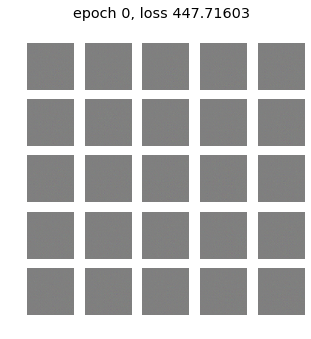

In [56]:
# Callback
def generate_images(model, epoch, noise_vector):
  predictions = model.decode(noise_vector)
  n = int(np.sqrt(num_examples_to_generate))
  fig = plt.figure(figsize=(n,n))
  for i in range(predictions.shape[0]):
      plt.subplot(n, n, i+1)
      if num_colors == 1:
         plt.imshow(predictions[i, :, :, 0], cmap='gray')
      else:
         plt.imshow(predictions[i, :, :, :])
      plt.axis('off')
  
  
num_examples_to_generate = 25 # 16
# We use fixed noise vector to generate samples during training so
# it will be easier to see the improvement.
random_vector_for_generation = tf.random.normal(
    shape=[num_examples_to_generate, model.latent_dim])

# we assume model.compute_loss(batch) is defined
# as well as test_dataset
def callback(model, epoch, elapsed_time):
  loss_tracker = tf.keras.metrics.Mean()
  for batch in test_dataset:
    loss_tracker(model.compute_loss(batch))
  test_loss = loss_tracker.result()
  #display.clear_output(wait=False) # don't erase old outputs
  print('Epoch {}, Test loss: {:0.5f}, time {:0.2f}'.format(
            epoch, test_loss, elapsed_time)) 
  generate_images(model, epoch, random_vector_for_generation)
  plt.suptitle('epoch {}, loss {:0.5f}'.format(epoch, test_loss), fontsize='x-large')
  plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
  plt.show()

  
  
# Test 
callback(model, 0, 42)

In [0]:
# generic (model agnostic) training function.
# model must support these methods:
# g = model.compute_gradients(X)
# model.traininable_variables (so model is a subclass of Keras.Model)

# Callback has following interface: callback(model, epoch, elapsed_time)

def train_model(model, optimizer, train_dataset,
                epochs, callback=None, print_every_n_epochs=1):
  for epoch in range(0, epochs):
    start_time = time.time()
    for batch in train_dataset:
      gradients = model.compute_gradients(batch)
      optimizer.apply_gradients(zip(gradients, model.trainable_variables))
    end_time = time.time()
    elapsed_time = end_time - start_time
    if callback:
       callback(model, epoch, elapsed_time)                               
  return model

Epoch 0, Test loss: 124.50700, time 25.37


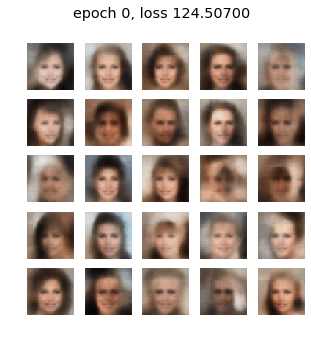

Epoch 1, Test loss: 120.93724, time 25.23


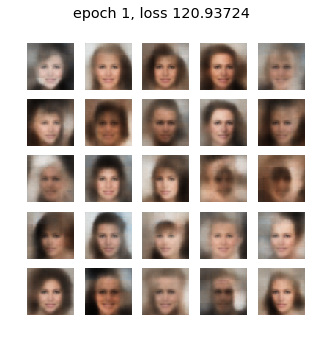

Epoch 2, Test loss: 118.24430, time 25.37


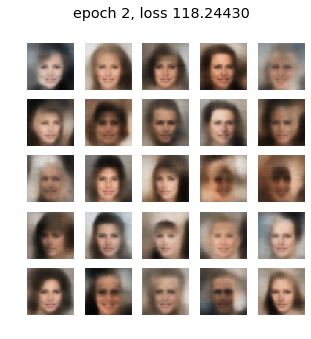

Epoch 3, Test loss: 116.74141, time 25.32


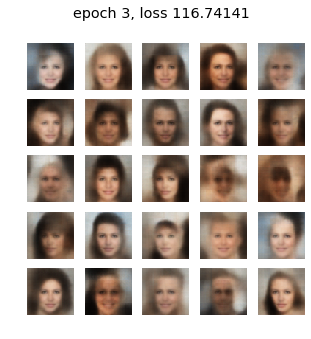

Epoch 4, Test loss: 116.25228, time 25.04


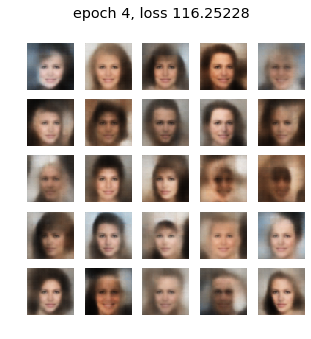

Epoch 5, Test loss: 116.09283, time 25.10


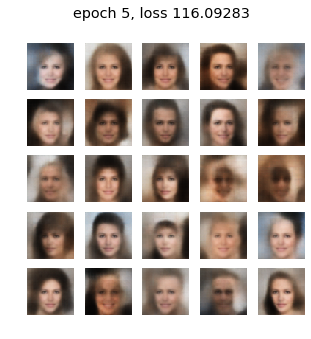

Epoch 6, Test loss: 114.66879, time 25.20


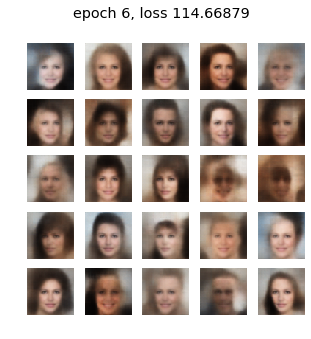

Epoch 7, Test loss: 114.23098, time 25.14


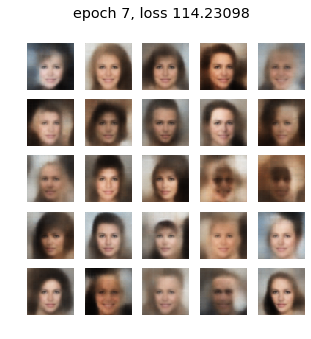

Epoch 8, Test loss: 113.29477, time 25.16


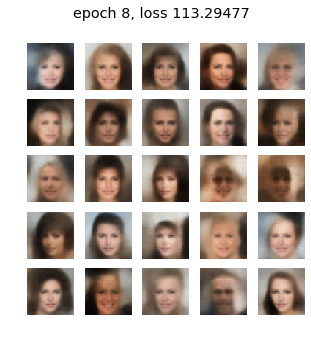

Epoch 9, Test loss: 112.76565, time 25.08


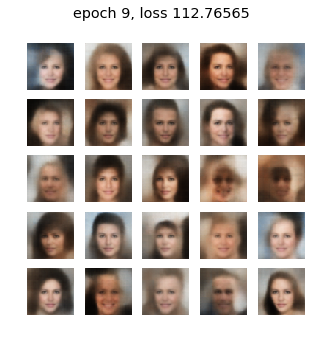

Epoch 10, Test loss: 112.72684, time 25.23


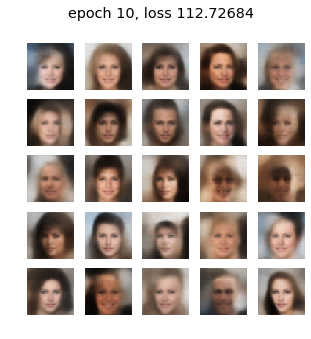

Epoch 11, Test loss: 112.19326, time 24.90


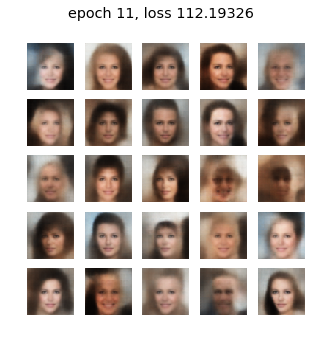

Epoch 12, Test loss: 112.64806, time 24.75


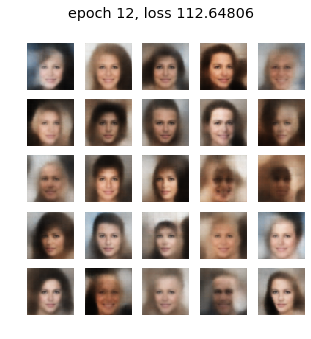

Epoch 13, Test loss: 111.82522, time 24.14


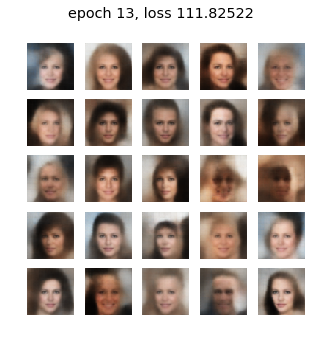

Epoch 14, Test loss: 111.75057, time 24.77


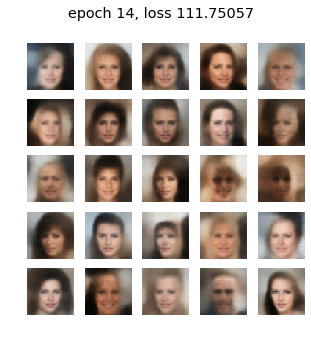

Epoch 15, Test loss: 111.60398, time 24.81


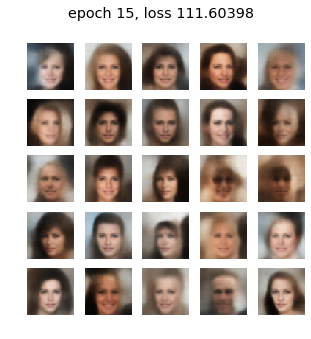

Epoch 16, Test loss: 111.21474, time 24.94


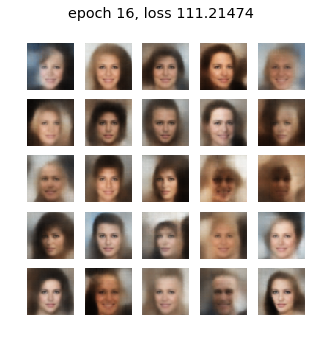

Epoch 17, Test loss: 110.98907, time 24.74


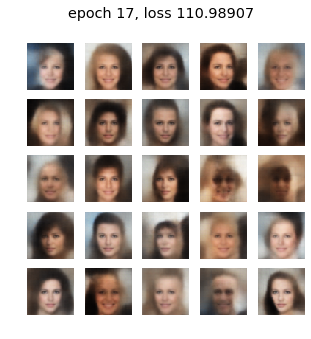

Epoch 18, Test loss: 110.73291, time 24.82


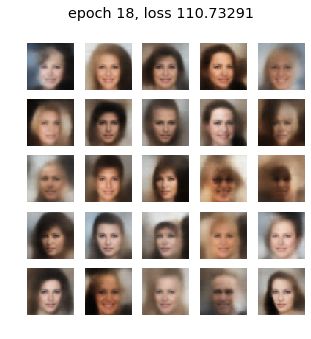

Epoch 19, Test loss: 111.27232, time 24.83


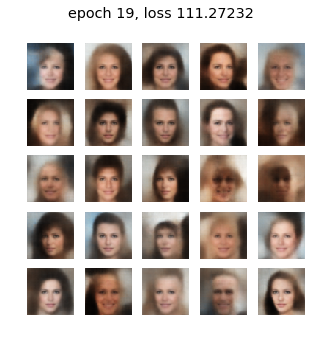

Epoch 20, Test loss: 110.24523, time 24.57


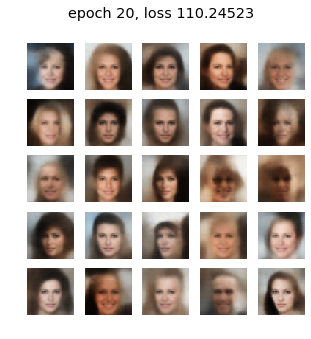

Epoch 21, Test loss: 110.50471, time 24.67


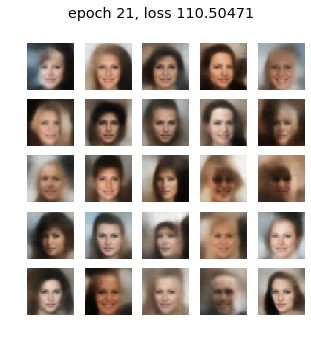

Epoch 22, Test loss: 110.09599, time 24.64


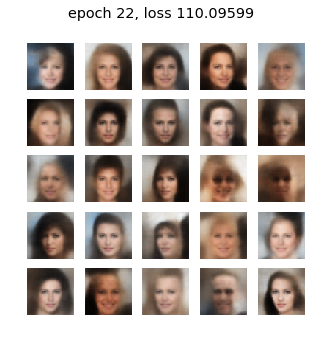

Epoch 23, Test loss: 110.13026, time 24.71


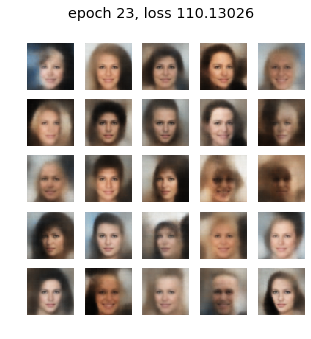

Epoch 24, Test loss: 109.90836, time 24.58


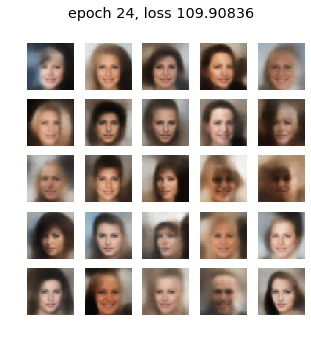

Epoch 25, Test loss: 109.71429, time 24.64


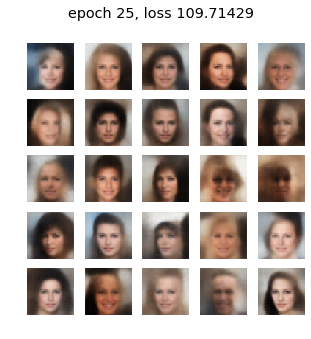

Epoch 26, Test loss: 109.63181, time 24.51


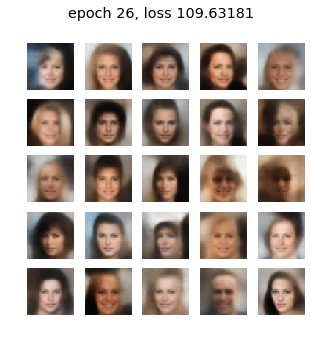

Epoch 27, Test loss: 109.91938, time 24.71


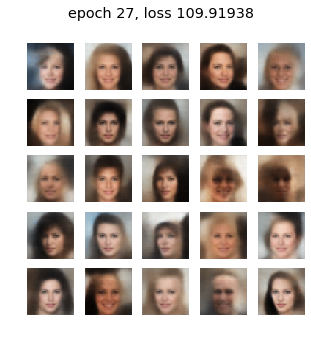

Epoch 28, Test loss: 109.40000, time 24.72


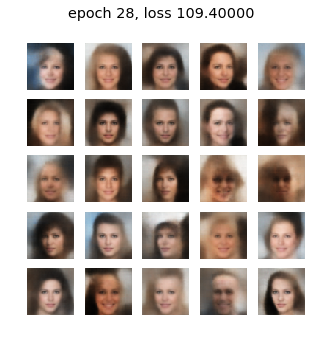

Epoch 29, Test loss: 109.17235, time 24.39


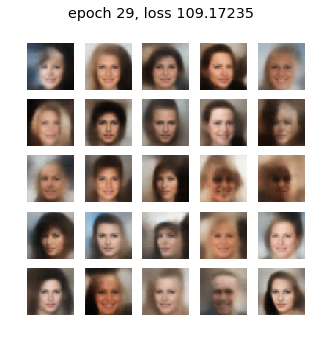

In [59]:
optimizer = tf.keras.optimizers.Adam(1e-3)
epochs = 30


model = train_model(model, optimizer, train_dataset, epochs, callback)

In [0]:

folder = 'vae_celeba_30epochs'
if not os.path.exists(folder):
      os.makedirs(folder)
    
save_vae(model, folder)


In [0]:
# Save out of colab
from google.colab import files
files.download(os.path.join(folder, 'params.pkl'))

In [0]:

files.download(os.path.join(folder, 'weights.h5'))

# Post-training

### Display images generated during training

In [0]:
def read_image(epoch_no):
  return PIL.Image.open('image_at_epoch_{:04d}.png'.format(epoch_no))

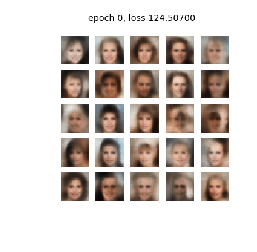

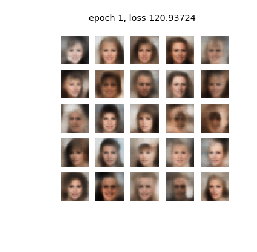

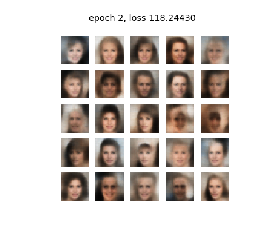

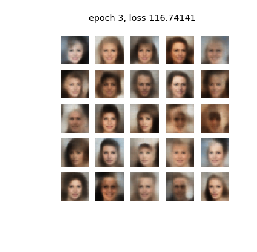

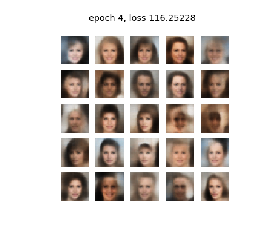

...

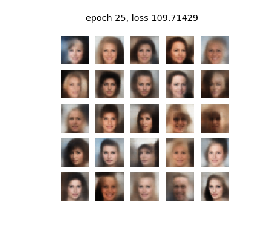

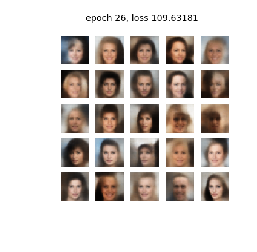

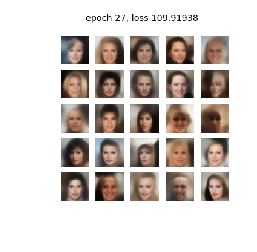

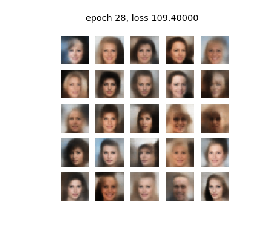

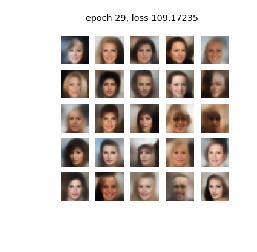

In [65]:
for i in range(epochs):
  plt.imshow(read_image(i))
  plt.axis('off')
  #plt.title('epoch {}'.format(i))
  plt.show()

In [0]:
# Make some wrapper functions so we can reuse code from
# https://github.com/davidADSP/GDL_code/blob/master/03_03_vae_faces_analysis.ipynb
  

def vae_encode(model, x):
    mean, logvar = model.inference_net(x)
    return mean

def vae_decode(model, z_points):
    return model.decode(z_points)


In [69]:
from google.colab import files
files.upload() # load list_attr_celeba.csv


Saving list_attr_celeba.csv to list_attr_celeba.csv


{'list_attr_celeba.csv': b'image_id,5_o_Clock_Shadow,Arched_Eyebrows,Attractive,Bags_Under_Eyes,Bald,Bangs,Big_Lips,Big_Nose,Black_Hair,Blond_Hair,Blurry,Brown_Hair,Bushy_Eyebrows,Chubby,Double_Chin,Eyeglasses,Goatee,Gray_Hair,Heavy_Makeup,High_Cheekbones,Male,Mouth_Slightly_Open,Mustache,Narrow_Eyes,No_Beard,Oval_Face,Pale_Skin,Pointy_Nose,Receding_Hairline,Rosy_Cheeks,Sideburns,Smiling,Straight_Hair,Wavy_Hair,Wearing_Earrings,Wearing_Hat,Wearing_Lipstick,Wearing_Necklace,Wearing_Necktie,Young\r\n000001.jpg,-1,1,1,-1,-1,-1,-1,-1,-1,-1,-1,1,-1,-1,-1,-1,-1,-1,1,1,-1,1,-1,-1,1,-1,-1,1,-1,-1,-1,1,1,-1,1,-1,1,-1,-1,1\r\n000002.jpg,-1,-1,-1,1,-1,-1,-1,1,-1,-1,-1,1,-1,-1,-1,-1,-1,-1,-1,1,-1,1,-1,-1,1,-1,-1,-1,-1,-1,-1,1,-1,-1,-1,-1,-1,-1,-1,1\r\n000003.jpg,-1,-1,-1,-1,-1,-1,1,-1,-1,-1,1,-1,-1,-1,-1,-1,-1,-1,-1,-1,1,-1,-1,1,1,-1,-1,1,-1,-1,-1,-1,-1,1,-1,-1,-1,-1,-1,1\r\n000004.jpg,-1,-1,1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,1,-1,-1,1,-1,-1,-1,-1,1,-1,1,-1,1,1,-1,1\r

In [0]:
files.upload() # load image_align_celeba.zip

Saving img_align_celeba.zip to img_align_celeba.zip


In [0]:
!unzip celeba.zip